# Assigment 2: CAMSHIFT
## Paper
Lies das Paper "Bradski_etal_1998_camshift.pdf" im KVV (unter "Resources"). 

## Histogramm berechnen
* Implementiere eine Funktion, die ein Farbhistogramm erstellt. Übergebe entweder ein Bild und ein ROI, oder das dem ROI unterliegende Bild. 
* Hierzu ermögliche durch die Übergabe eines zweiten (bzw. dritten) Parameters die Zusammenfassung von Farbwerten in n Bins. 
* Lade das Bild "images/racecar.png" und konvertiere das Bild in den HSV-Farbraum. Plotte den Hue-Kanal. (**RESULT**)

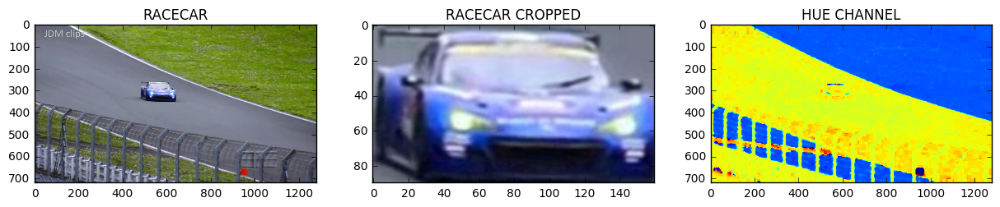

In [3]:
%matplotlib inline 
from skimage import io,color
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.patches as patches
import os
import warnings; warnings.simplefilter('ignore')


IMAGES_PER_ROW = 4

MIN_SATURATION_CAR = 0.2
MIN_VALUE_CAR = 0.5
MIN_SATURATION_TACO = 0.8
MIN_VALUE_TACO = 0.2

ROI_FRAME_MARGIN_CAR = 60
ROI_FRAME_MARGIN_TACO = 20


image = io.imread('images/racecar.png')
imageCar = image[260:350, 480:640]

fig = plt.figure(figsize=(15, 10))
ax1 = plt.subplot(1, 3, 1)
ax1.set_title("RACECAR")
ax2 = plt.subplot(1, 3, 2)
ax2.set_title("RACECAR CROPPED")

ax1.imshow(image)
ax2.imshow(imageCar)

# hsv image
hsv = color.rgb2hsv(image)
h_channel = hsv[:,:,0]
ax3 = plt.subplot(1,3,3)
ax3.set_title("HUE CHANNEL")
ax3.imshow(h_channel)    

In [4]:
def createColorHistogram(img, binCount, out=plt, roi=None):
    #convert image to hsv
    hsv = color.rgb2hsv(img)
    
    # only integer values allowed
    binCount = int(binCount)
    if binCount < 1:
        print("binCount must be > 0")
        return None
    
    
    # get ROI image slice
    if roi:
        roi_x = roi[0]
        roi_y = roi[1]
        roi_width = roi[2]
        roi_height = roi[3]
        hsv_roi = hsv[roi_x:roi_x+width//2, roi_y:roi_y+height//2,:]
    else:
        hsv_roi = np.copy(hsv)
    
    # we are only interested in the color values
    h_channel = hsv_roi[:,:,0]
    size = h_channel.shape[0] * h_channel.shape[1]
    
    # create bins
    stepsize = 1 / binCount
    bins={0:(0.0, stepsize)}
    prob = {i:0 for i in range(binCount)}
    for i in range(binCount)[1:]:
        # define bin borders
        bin_start = bins[i-1][1]
        bin_end = bin_start + stepsize
        bins[i] = (bin_start, bin_end)
        
        # count appearances for each bin
        lower_bound_mask = h_channel >= bin_start
        upper_bound_mask = h_channel < bin_end
        and_mask = np.logical_and(lower_bound_mask, upper_bound_mask)
        nrOfAppearances = np.sum(and_mask)
        prob[i] = nrOfAppearances / size
    
    # plot the histogram
    x_pos = np.arange(binCount)
    y = [prob[i] for i in range(binCount)]
    
    out.bar(x_pos, y, align="center",width=1.0, edgecolor="black")
    out.plot()
    
    return bins, prob

* stelle das Histogramm über dem Hue-Kanal für das gesamte Bild und für den Ausschnitt (x,y) = (480, 260) bis (640, 350) dar. Variiere auch mal testweise die Zahl der Bins(**RESULT**)


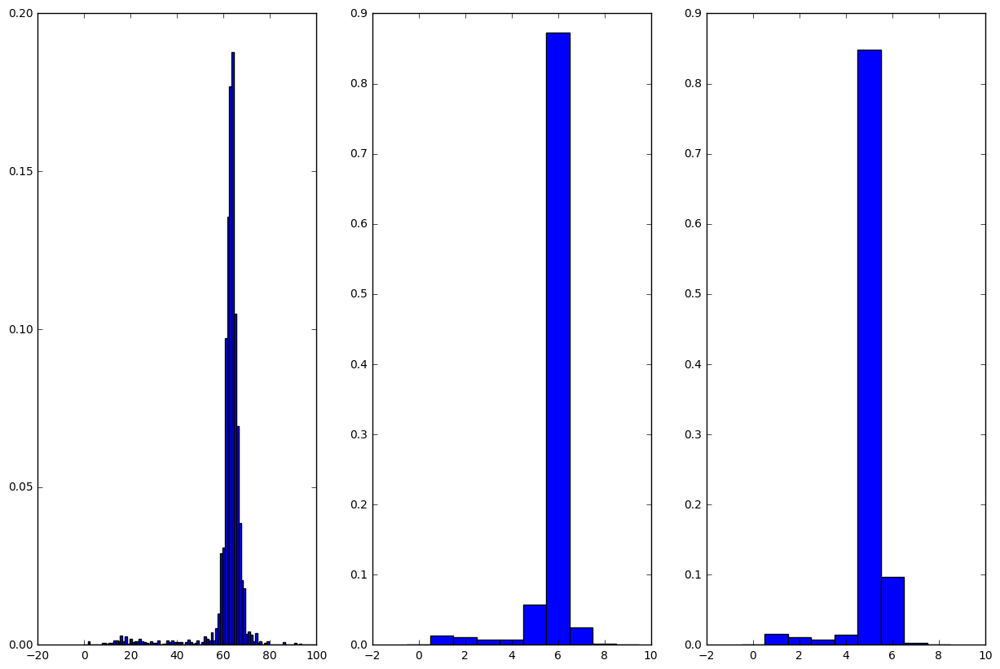

In [5]:
fig = plt.figure(figsize=(15, 10))
ax1 = plt.subplot(1, 3, 1)
ax2 = plt.subplot(1, 3, 2)
ax3 = plt.subplot(1, 3, 3)
    
histCar100 = createColorHistogram(imageCar, 100, ax1)
histCar10 = createColorHistogram(imageCar, 10, ax2)
histCar9 = createColorHistogram(imageCar, 9, ax3)

## Wahrscheinlichkeitsverteilung
* implementiere die Methode aus der Vorlesung, die Dir - gegeben ein Hue-Histogramm - die Objekt-Wahrscheinlichkeitsverteilung für ein neues Bild berechnet. 
* erzeuge das Histogramm des Autos aus dem Bild "racecar.png" und wende die neue Funktion auf das letzte frame des Videos (images/racecar/151.jpg) an (**RESULT**)

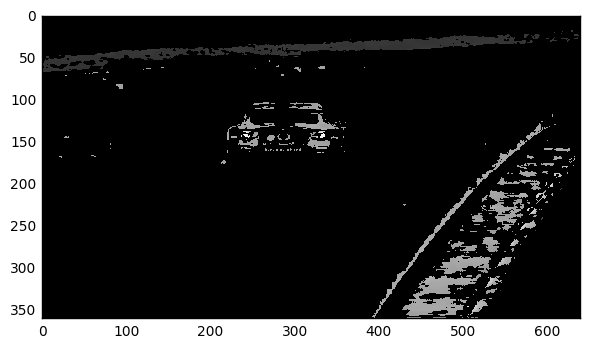

In [7]:
def createProbDistribution(image, objectHist, nbins, minSaturation, minValue):
    # convert to hsv
    img_copy = np.copy(image)
    hsv = color.rgb2hsv(img_copy)
    
    # get channels
    h_channel = hsv[:,:,0]
    s_channel = hsv[:,:,1]
    v_channel = hsv[:,:,2]
    
    # filter out pixels that do not have the S OR V requirements
    s_mask = s_channel < minSaturation
    v_mask = v_channel < minValue
    or_mask = np.logical_or(s_mask, v_mask)
    h_channel[or_mask] = np.inf
    
    bins = objectHist[0].items()
    prob = objectHist[1]
    for i,bounds in bins:
        low_bound = bounds[0]
        up_bound = bounds[1]
        
        low_mask = h_channel <= low_bound
        up_mask = h_channel > up_bound
        and_mask = np.logical_and(low_mask, up_mask)
        
        h_channel[and_mask] = prob[i]
    
    # set probability of unwanted pixels to zero
    unwanted_mask = h_channel==np.inf
    h_channel[unwanted_mask] = 0.0
    
    return h_channel
    
    
nbins = 9
lastFrame = io.imread('images/racecar/151.jpeg')
histogramCar = createColorHistogram(imageCar, nbins, ax1)
probDistr = createProbDistribution(lastFrame, histogramCar, nbins, MIN_SATURATION_CAR, MIN_VALUE_CAR)
io.imshow(probDistr)

### ROI auf Bild anzeigen


In [ ]:
def drawROI(image, roi, out = plt):
    x = roi[0]
    y = roi[1]
    width = roi[2]
    height = roi[3]
    currentAxis = out
    currentAxis.add_patch(
        patches.Rectangle(
            (x-width//2, y-height//2),
            width,
            height,
            fill=False,
            edgecolor="red",
            linewidth=5
        )
    )
    
    out.imshow(image)

drawROI(image, (560, 300, 160, 90), out=plt.gca())

##  Exercise 1.2 - Mean Shift
* Implementiere die Verschiebung und des ROI wie in der Vorlesung beschrieben. Teste den Algorithmus auf den Bildfolgen "images/racecar/*.jpg" oder "images/taco/*.jpg". Wähle das Tracking-Fenster geeignet (zur Reduktion der Dateigröße habe ich die Bilder um Faktor 2 verkleinert, d.h. die ROI von oben muss entsprechend angepasst werden). 
* Zeichne als Ausgabe die Trajektorie (die Bewegungsspur) der Objekte, wie durch CAMSHIFT zurückgegeben. (**RESULT**)

In [8]:
def calcMoments(prob_distr):
    # zeroth moment
    zero_mom = np.sum(prob_distr)
    
    # first moment x
    x_weighted_prob = prob_distr * [i for i in range(1, prob_distr.shape[1]+1)] 
    f1_mom = np.sum(x_weighted_prob)
    
    # first moment y
    y_weighted_prob = prob_distr * np.array([[i] for i in range(1, prob_distr.shape[0]+1)])
    f2_mom = np.sum(y_weighted_prob)
    
    return zero_mom, f1_mom, f2_mom


def mean_shift(prob_distr, old_roi, thresh):
    """Takes the object-probability distribution 
    of the new frame, ROI of the previous frame
    and a threshold for mean shift convergance
    and returns the new region of interest."""
    
    # parameters of old roi
    old_center_x = old_roi[0]
    old_center_y = old_roi[1]
    width = old_roi[2]
    height = old_roi[3]
    # distance from old center to new center
    distance = thresh + 1
    # avoid infinite loops by using a counter for max iterations
    counter = 0
    
    while(distance>thresh and counter<5):
        
        # Step 1: calculate new center of mass
    
        # slice of prob_distr
        roi_x_start = int(old_roi[0] - width//2)
        roi_x_end = int(old_roi[0] + width//2)
        roi_y_start = int(old_roi[1] - height//2)
        roi_y_end = int(old_roi[1] + height//2)
        prob_distr_slice = prob_distr[roi_y_start:roi_y_end, roi_x_start:roi_x_end]

        # 1.1 calculate moments
        z_mom, f1_mom, f2_mom = calcMoments(prob_distr_slice)
        
        # 1.2 calculate center offset
        # since those are the center coordinates in reference to the prob SLICE
        # whose coordinates start at (1,1) instead of (roi_x_start, roi_y_start)
        # the calculation of the new center must be seen as an offset to the 
        # top left corner of the old ROI window
        center_x_offset = f1_mom // z_mom
        center_y_offset = f2_mom // z_mom
        center_x = roi_x_start + center_x_offset
        center_y = roi_y_start + center_y_offset
        
        # Step 2: calculate distance for convergence test
        delta_x = center_x - old_center_x
        delta_y = center_y - old_center_y
        distance = np.sqrt(delta_x**2 + delta_y**2)
        new_roi = [center_x, center_y, width, height]
        
        # prepare for new iteration if necessary
        old_roi = new_roi
        old_center_x = center_x
        old_center_y = center_y
        
        counter += 1
        
    
    return new_roi

In [ ]:
def ROI_diashow(nrOfFrames, rows, cols):
    dia_fig = plt.figure(figsize=(150, 150))
    frames = []
    index = 1
    nbins = 9
    histogramCar = createColorHistogram(imageCar, nbins, plt.gca())
    current_ROI = (280, 150, 80, 45)
    for i in range(nrOfFrames):
        frame_name = '000' + str(i) + '.jpeg'
        frame_name = frame_name[-8:]
        frame_name = 'images/racecar/' + frame_name
        frame = io.imread(frame_name)
        frames.append(frame)
    
    
    frame1 = frames[0]
    ax_start = plt.subplot(rows, cols, index)
    drawROI(frame1, current_ROI, ax_start)
    index += 1
    
    for frame in frames[1:]:
        probDistr = createProbDistribution(frame, histogramCar, nbins, MIN_SATURATION_CAR, MIN_VALUE_CAR)
        current_ROI = mean_shift(probDistr, current_ROI, 50)
        ax = plt.subplot(rows, cols, index)
        drawROI(frame, current_ROI, ax)
        index += 1

In [36]:
ROI_diashow(50, 10, 5)

In [5]:
imgs = []
path = "/home/franziska/Dropbox/Freie Universität/Master/ComputerVision/cv201718_assignments/images/racecar"
image_name_list = sorted(os.listdir(path))
for image_name in image_name_list:
    imgs.append(io.imread(os.path.join(path,image_name)))

In [6]:
def mean_shift_tracking(images, template_image, nbins=9):
    track = []
    
    image = images[0]
    
    # create the template
    histogramCar = createColorHistogram(template_image, nbins, ax3)
    
    for image in images[1:]:

        probDistr = createProbDistribution(image, histogramCar, nbins, MIN_SATURATION_CAR, MIN_VALUE_CAR)
        c_x, c_y, w, h = mean_shift(probDistr, (280, 150, 80, 45), 20)
        
        track.append((c_x,c_y))
    return track

In [9]:
track = mean_shift_tracking(imgs, imageCar)

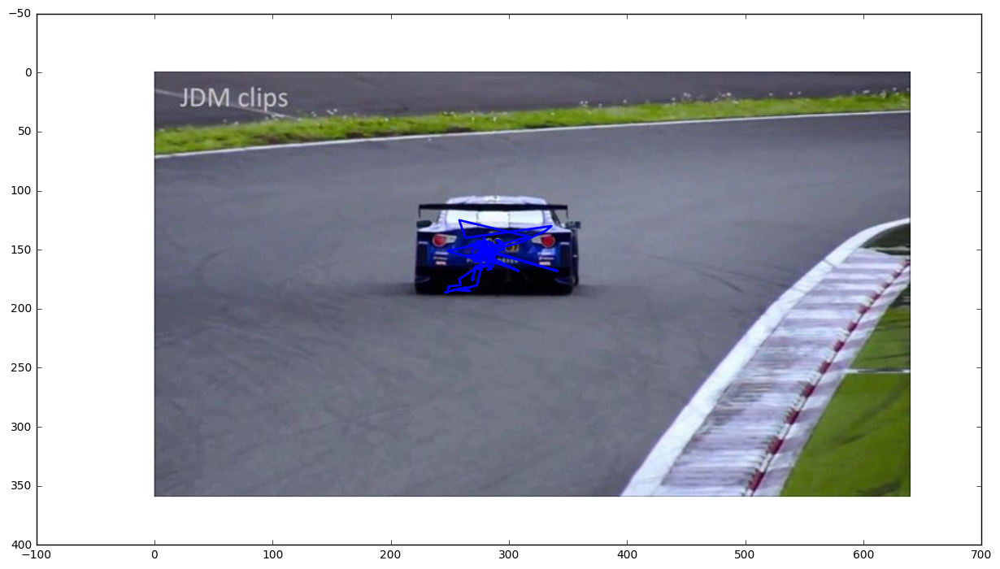

In [10]:
yList = [p[1] for p in track]
xList = [p[0] for p in track]
fig = plt.figure(figsize=(15, 10))
ax1 = plt.subplot(1, 1, 1)
img = imgs[0]
ax1.imshow(imgs[-1])

ax1.plot(xList, yList, linewidth=2)

##  Exercise 1.2 - CAMSHIFT
* erweitere Deinen Algorithmus um die Anpassung der Größe des ROI und das Finden der Objektorientierung
* führe den Algorithmus wieder auf eine der Bildfolgen aus und zeichne eine Ellipse auf das Bild, die die gefundenen Parameter repräsentiert (**RESULT**)

### Hilfsfunktionen für Größe/Orientierung

In [11]:
def moment_hu(img):
    return(cv2.moments(img))

def calculate_center_with_cv2(binary_image):
    M = moment_hu(binary_image)
    # taken from https://docs.opencv.org/3.4.0/dd/d49/tutorial_py_contour_features.html
    cx = int(M['m10']/M['m00'])
    cy = int(M['m01']/M['m00'])
    return (cx, cy)


def calculate_orientation(binary_image):
    # nachimplementierung der formel auf der folie zu object orientation
    
    # use the cv2 function to make it faster 
    M = moment_hu(binary_image)
    
    cx = int(M['m10']/M['m00'])
    cy = int(M['m01']/M['m00'])
    
    m00 = M['m00']
    m10 = M['m10']
    m01 = M['m01']
    m11 = M['m11']
    
    m20 = M['m20']
    m02 = M['m02']
    
    on = 2*(m11/m00 - cx*cy)
    o1n = m20/m00 - cx**2
    o2n = m02/m00 - cy**2
    un = o1n - o2n
    
    tan = np.arctan(on/un)
    return tan/2

### CamShift ähnelt dem Mean Shift, außer der dynamischen Größen-Orientierungsanpassung

In [12]:
def cam_shift(prob_distr, old_roi, thresh):
    """Takes the object-probability distribution 
    of the new frame, ROI of the previous frame
    and a threshold for mean shift convergance
    and returns the ellipse and its orientation."""
    
    # parameters of old roi
    old_center_x = old_roi[0]
    old_center_y = old_roi[1]
    width = old_roi[2]
    height = old_roi[3]
    # distance from old center to new center
    distance = thresh + 1
    # avoid infinite loops by using a counter for max iterations
    counter = 0
    
    while(distance>thresh and counter<10):
        
        # Step 1: calculate new center of mass
    
        # slice of prob_distr
        roi_x_start = old_roi[0] - width//2
        roi_x_end = old_roi[0] + width//2
        roi_y_start = old_roi[1] - height//2
        roi_y_end = old_roi[1] + height//2
        prob_distr_slice = prob_distr[roi_y_start:roi_y_end, roi_x_start:roi_x_end]

        # 1.1 calculate moments
        z_mom, f1_mom, f2_mom = calcMoments(prob_distr_slice)
        
        # 1.2 calculate center offset
        # since those are the center coordinates in reference to the prob SLICE
        # whose coordinates start at (1,1) instead of (roi_x_start, roi_y_start)
        # the calculation of the new center must be seen as an offset to the 
        # top left corner of the old ROI window
        center_x_offset = f1_mom // z_mom
        center_y_offset = f2_mom // z_mom

        center_x = roi_x_start + center_x_offset
        center_y = roi_y_start + center_y_offset
        
        # Step 2: calculate distance for convergence test
        delta_x = center_x - old_center_x
        delta_y = center_y - old_center_y
        distance = np.sqrt(delta_x**2 + delta_y**2)
        new_roi = [center_x, center_y, width, height]
        
        # prepare for new iteration if necessary
        old_roi = new_roi
        old_center_x = center_x
        old_center_y = center_y
        
        
    # after the threshold is reached: 
    size = 2*math.sqrt(z_mom/256)
    orientation = calculate_orientation(prob_distr_slice)
    
    # the new search window is bigger: 
    return new_roi, size, orientation

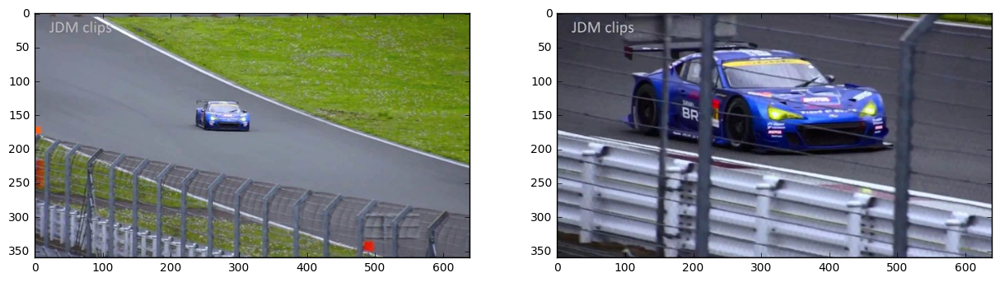

In [13]:
image_begin = imgs[0]
image_compate = imgs[67]
fig1 = plt.figure(figsize=(15, 10))
ax3 = plt.subplot(1,2,1)
ax4 = plt.subplot(1, 2, 2)

ax3.imshow(image_begin)
ax4.imshow(image_compate)

In [15]:
import math
import cv2

In [16]:
nbins = 9
histogramCar = createColorHistogram(imageCar, nbins, ax3)
probDistr = createProbDistribution(image_compate, histogramCar, nbins, MIN_SATURATION_CAR, MIN_VALUE_CAR)
roi, size, orientation = cam_shift(probDistr, (280, 150, 80, 45), 20)

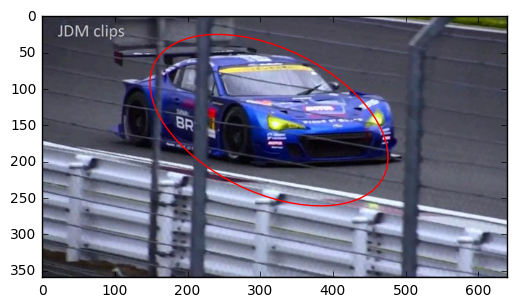

In [17]:
def drawEllipse(image, roi, angle, size, out = plt):
    x = roi[0]
    y = roi[1]
    width = roi[2]*size
    height = roi[3]*size
    angle = angle
    currentAxis = out
    currentAxis.add_patch(
        patches.Ellipse(
            (x, y),
            width,
            height,
            angle,
            fill=False,
            edgecolor="red"
        )
    )
    
    out.imshow(image)

drawEllipse(image_compate, roi, math.degrees(orientation), size, out=plt.gca())